#  Deep Learning for Time Series 

Pridect Goldman Saches daily stock price direction

CQF Final Project

by Zhenxian(Jason) Lu

luzhenxian@hotmail.com

Report: https://drive.google.com/file/d/1UdLSv9GC53PTp5DrTpJoFnZ4uzMFDkYZ/view?usp=share_link

* [1. Problem Definition](#1)
* [2. Load Libraries and  Retrieval data](#2)
* [3. Feature Engineering](#3)
    * [3.1  Define Technical Indicators](#3.1)
    * [3.2  Define Label](#3.2)
    * [3.3  Data Cleaning](#3.3)
* [4. Descriptive Statistics](#4)
* [5. Data Process](#5)     
    * [5.1. Feature Selection](#5.1)
    * [5.2. Prerocess Data for Deep Learning](#5.2)
* [6.  EDA and  Visualization](#6)
    * [6.1 Feature selection)](#6.1) 
    * [6.2 Model selection)](#6.2) 
* [7.  Deep Learning](#7)
    * [7.1 Make RNN Models)](#7.1) 
    * [7.2 Evaluate Performace)](#7.2) 
    * [7.3 Model Tuning)](#7.3)
* [8.  Backtest](8)
* [9.  Appendix](8)


In [ ]:
! pip install yfinance watermark keras_self_attention minisom scikit-plot 

     |████████████████████████████████| 6.3 MB 9.2 MB/s 
  Created wheel for yfinance: filename=yfinance-0.1.63-py2.py3-none-any.whl size=23918 sha256=116253d29a5e6788e9f870a3e2ce6945918a874eb5f150cae57fa93e3da2be7a
  Stored in directory: /root/.cache/pip/wheels/fe/87/8b/7ec24486e001d3926537f5f7801f57a74d181be25b11157983
  Created wheel for keras-self-attention: filename=keras_self_attention-0.50.0-py3-none-any.whl size=19414 sha256=81e8eaa267436e2c32c3d9d803a220f3c4cb597e33c9fcf693de28f70065ca23
  Stored in directory: /root/.cache/pip/wheels/92/7a/a3/231bef5803298e7ec1815215bc0613239cb1e9c03c57b13c14
  Created wheel for minisom: filename=MiniSom-2.2.9-py3-none-any.whl size=8594 sha256=16da596669ca47b06d0f75c6c59dfd93a130b710bde5a0d82fe77d25df53fa4a
  Stored in directory: /root/.cache/pip/wheels/3d/a1/10/f50b6f4865652eac239a2700de411c3078c27e1318320e494c
Successfully built yfinance keras-self-attention minisom
  Attempting uninstall: lxml
    Found existing installation: lxml 4.2.6
   

<a id='1'></a>
## 1. Problem Definition


This task is to predict the price direction of Goldman Saches using Long-Short Term Memory (LSTM). Stock price can be affected by many factors, such as macroeconomy indicators, prices of competitors, foreign exchange, commodities, technical indicators, fundamental indicators, and market expectations and so on.

<a id='2'></a>
## 2.  Load Libraries and Retrieval data

In [ ]:
# Load libraries
import numpy as np
import pandas as pd

# Retrieve data
import yfinance as yf
import pandas_datareader.data as web
from pandas_datareader import data
import pandas_datareader as pdr
from pandas_datareader.famafrench import get_available_datasets
# Deep Learning
import tensorflow
from tensorflow import keras
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l1_l2, l2,l1
from tensorflow.keras import models, initializers, layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dropout, Dense, LSTM, Input,Flatten, GRU, SimpleRNN, RNN, ELU
from tensorflow.keras.layers import TimeDistributed,BatchNormalization, Bidirectional, RepeatVector
from tensorflow.keras.optimizers import Adam, RMSprop, SGD, Nadam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier
from tensorflow.keras.layers import Conv1D, MaxPooling1D, ConvLSTM2D
from tensorflow.keras.experimental import PeepholeLSTMCell

# Visualization
import matplotlib.pyplot as plt
from pandas import read_excel, set_option
from pandas.plotting import scatter_matrix
import seaborn as sns
import plotly
import plotly.express as px
import plotly.graph_objects as go
import cufflinks as cf
cf.set_config_file(offline=True)

# colab plot display
import plotly.io as pio
pio.renderers.default = 'colab'

# Machine learning algos
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import StratifiedKFold,GridSearchCV,KFold
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2, f_regression
from sklearn.pipeline import Pipeline

# statsmodels
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Metrics
from sklearn.metrics import classification_report, confusion_matrix, \
      accuracy_score,plot_confusion_matrix,\
      plot_roc_curve, roc_curve, roc_auc_score,auc
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import mean_squared_error, r2_score

# others
import IPython
import IPython.display
from pathlib import Path
from time import time
from tqdm.notebook import tqdm
import datetime, os
#Disable the warnings
import warnings
warnings.filterwarnings('ignore')

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



In [ ]:
%load_ext watermark
%watermark -a "Zhenxian Lu" -u -d -p numpy,scipy,tensorflow,plotly

Author: Zhenxian Lu

Last updated: 2021-08-23

numpy     : 1.19.5
scipy     : 1.4.1
tensorflow: 2.6.0
plotly    : 4.4.1



I am going to pridict the stock price of Goldman Saches, so ckeck its price changes first for an intuition.

In [ ]:
# define data start date and end date
START = '2001-06-15'
END = '2021-06-15'

In [ ]:
# Check Trend and seasonality of Adj price
# resample to monthly data
GS_monthly = yf.download('GS',start =START, end=END).resample('M').last()
# decomposite trend and seasonality
res = sm.tsa.seasonal_decompose(GS_monthly['Adj Close'], freq=52)
df = pd.concat([res.observed,res.trend,res.resid,res.seasonal], axis=1)
# plot
df.iplot(title = 'Goldman Saches Stock Price Breakdown')

[*********************100%***********************]  1 of 1 completed


The chart about shows that the adjust close price of Goldman Saches has an upward trend from 2003 to 2019. And then I will use ticker data and technical indicators to predict its price direction.

Stock price can be affected by many factors, such as macroeconomy indicators, prices of competitors, foreign exchange, commodities, technical indicators, fundamental indicators, and market expectations and so on. To predict the price direction of Goldman Saches in this task, features include its competitors, market index, oil and gas futures price, Fama Frence five factors and federal funds rate.

|Tickers  | Name|
|---|---|
|HSBC|HSBC|
|MS|Morgan Stanley|
|JPM  | JPMgroup Inc   |
|BAC| Bank of America Corp|
|BK|Bank of New York Mellon Corp|
|AXP|American Express Company|
|WFC|Wells Fargo & Company|
|EFFR|Effective Federal Funds rate|
|DTWEXBGS|US Dollar Index|
|^GSPC|SP500|
|^VIX|Cboe Volatility Index |
|^DJI|Dow Jones Industrial Average|
|^IXIC|NASDAQ Composite |
|CL=F|Crude Oil |
|NG=F|Natural Gas|
|FF|FamaFrench_Research_Data_5_Factors|

In [ ]:
# retrieval data
eco_tickers = ['EFFR'] # Macro economy indicator 
bank_tickers = ['HSBC','JPM','MS','BAC','BK','AXP','WFC']   # bank tickers
index_tickers = ['^GSPC', '^VIX', '^IXIC','^DJI']  # Index  tickers
futures_tickers = ['CL=F','NG=F']      # futures tickers
# retrieval Adjust Close price data from yahoo and resample them as weekly data
bank_data  = yf.download(bank_tickers,         start=START, end=END)['Adj Close']
futures_data  = yf.download(futures_tickers,   start=START, end=END)['Adj Close']
index_data = yf.download(index_tickers,        start=START, end=END)['Adj Close']
eco_data = web.DataReader(eco_tickers, 'fred', start=START, end=END)
# change index name
eco_data.index.names = ['Date']

[*********************100%***********************]  7 of 7 completed
[*********************100%***********************]  2 of 2 completed
[*********************100%***********************]  4 of 4 completed


In [ ]:
eco_data.iplot(title="Effective Federal Funds Rate")

In [ ]:
futures_data.iplot(title = 'Natural Gas and Crude Oil Futures Price',subplots=True)

In [ ]:
bank_data.iplot(title='Banks Stock Price',subplots=True)

Fama French 5 factors data

In [ ]:
# Fama French 5 factors data
FF_data = data.DataReader("F-F_Research_Data_5_Factors_2x3_daily", "famafrench",start=START,end=END)[0]
FF_data= FF_data.drop(['RF'],axis=1) # drop RF colums
FF_data.index = pd.to_datetime(FF_data.index) #necessar

In [ ]:
FF_data.iplot(title='Fama French 5 factors',subplots=True)

US Dollar Index to reflect the foreign exchange market

In [ ]:
fx_tickers = ['DX-Y.NYB']     # US Dollar Index 
fx_data = yf.download(fx_tickers, start=START, end=END)['Adj Close']
fx_data = pd.DataFrame(fx_data)
fx_data.rename(columns={ 'Adj Close': 'USDidx'},inplace=True)

[*********************100%***********************]  1 of 1 completed


In [ ]:
# combine data
ticker_data = pd.concat([eco_data,futures_data,index_data,bank_data,FF_data],axis=1)
# rename column name to make them readable
ticker_data.rename(columns={'LLOY.L': 'Lloyds', 'BARC.L': 'Barclays','^IXIC':'NASDAQ','^NYA':'NYSE',
                            '^DJI':'DJI','^GSPC':'SP500','^VIX':'VIX',
                            'CL=F':'OIL','NG=F':'Gas'},inplace=True)
set_option('precision', 4)          
ticker_data.head(2)

,EFFR,OIL,Gas,DJI,SP500,NASDAQ,VIX,AXP,BAC,BK,HSBC,JPM,MS,WFC,Mkt-RF,SMB,HML,RMW,CMA
Date,,,,,,,,,,,,,,,,,,,
2001-06-15,3.94,28.51,3.979,10623.6396,1214.3600,2028.4301,22.81,25.5580,17.7467,33.9695,22.8035,24.7406,32.8761,12.1981,-0.46,0.16,0.48,-0.01,0.52
2001-06-18,3.91,27.55,3.939,10645.3799,1208.4301,1988.6300,23.17,25.2955,18.1199,34.1446,22.8110,24.4155,32.7504,12.2320,-0.63,-0.51,0.94,1.33,0.51


<a id='3'></a>
## 3.  Feature Engineering

<a id='3.1'></a>
### 3.1 Define Technical Indicators

In [ ]:
# set ticker data as group 1 features
# X1 = np.log(ticker_data.drop(['Mkt-RF','SMB','HML','RMW','CMA'],axis=1)).diff(1)
X1 = ticker_data

Technical Indicatiors


Started by creating a data that contains the predictors which will be used to make the predictions, and the output variable.

The current Data of the Goldman Saches consists of date, open, high, low, close and Volume. Using this data we calculate the following  technical indicators:
* **Moving Average** : A moving average provides an indication of the trend of the price movement by cut down the amount of "noise" on a price chart. 
* **O-C**, **H-L** : are 1. open price minus 4. close price and 2. high minus 3. low price respectively
* **Stochastic Oscillator %K and %D** : A stochastic oscillator is a momentum indicator comparing a particular closing price of a security to a range of its prices over a certain period of time. %K and %D are s3. low and fast indicators.
* **Relative Strength Index(RSI)** :It is a momentum indicator that measures the magnitude of recent price changes to evaluate overbought or oversold conditions in the price of a stock or other asset. 
* **Rate Of Change(ROC)**: It is a momentum oscillator, which measures the percentage change between the current price and the n period past price. 
* **Momentum (MOM)** : It is the rate of acceleration of a security's price or volume – that is, the speed at which the price is changing.
* **Average True Range (ATR)** : The average true range (ATR) is a technical analysis indicator, introduced by market technician J. Welles Wilder Jr. in his book New Concepts in Technical Trading Systems, that measures market volatility by decomposing the entire range of an asset price for that period
* **Drift‐Independent Volatility** : https://www.jstor.org/stable/10.1086/209650?seq=1#metadata_info_tab_contents

* **oving Average Convergence Divergence (MACD)** M measures the relationships between two moving averages of an asset price

* **Commodity Channel Index (CCI)** : compares the current price to an average price over a period.



This task is to predict the stock price direction of Goldman Saches, so to retrieve data first

In [ ]:
#  retrieve Goldman Saches stock price 
Target_ticker = 'GS'
Target_Values = yf.download(Target_ticker, start=START, end=END)

[*********************100%***********************]  1 of 1 completed


In [ ]:
# Compute Volume Weighted Average Price (VWAP)
# Create VWAP function
'''
def VWAP(df):
    V = df['Volume'].values
    TP = (df['Low'] + df['Close'] + df['High']).div(3).values
    return df.assign(VWAP=(TP * V).cumsum() / V.cumsum())

Target_Values['VWAP']= VWAP(Target_Values).VWAP
'''

"\ndef VWAP(df):\n    V = df['Volume'].values\n    TP = (df['Low'] + df['Close'] + df['High']).div(3).values\n    return df.assign(VWAP=(TP * V).cumsum() / V.cumsum())\n\nTarget_Values['VWAP']= VWAP(Target_Values).VWAP\n"

In [ ]:
Target_Values.tail(2)

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2021-06-11,375.70,378.75,375.11,378.05,378.05,2117300
2021-06-14,377.43,378.75,370.70,372.92,372.92,2560500


In [ ]:
# initial dataframe for technicial indicator 
X2 = pd.DataFrame()
# initial a list for column name
col_name = []
# set time periods to compute different technicial indicators
days= [5,10,21,42,63,126,168,200]

In [ ]:
#calculation of exponential moving average
def EMA(df, n):
    EMA = pd.Series(df['Close'].ewm(span=n, min_periods=n).mean(), name='EMA' + str(n))
    return EMA

for i in days:   
    X2['EMA'+str(i)] = EMA(Target_Values , i)
    col_name.append('EMA'+str(i)) 

#calculation of rate of change
def ROC(df, n):  
    ROC = pd.Series(((df.diff(n - 1)  / df.shift(n - 1) ) * 100), name = 'ROC' + str(n))   
    return ROC

for i in days:   
    X2['ROC'+str(i)] = ROC(Target_Values['Close'], i)
    col_name.append('ROC'+str(i)) 

#Calculation of price momentum
def MOM(df, n):   
    MOM = pd.Series(df.diff(n), name = 'MOM' + str(n) )   
    return MOM

for i in days:   
    X2['MOM'+str(i)] = MOM(Target_Values['Close'], i) 
    col_name.append('MOM'+str(i)) 

#calculation of relative strength index
def RSI(series, period):
    delta = series.diff().dropna()
    u = delta * 0
    d = u.copy()
    u[delta > 0] = delta[delta > 0]
    d[delta < 0] = -delta[delta < 0]
    u[u.index[period-1]] = np.mean( u[:period] ) #first value is sum of avg gains
    u = u.drop(u.index[:(period-1)])
    d[d.index[period-1]] = np.mean( d[:period] ) #first value is sum of avg losses
    d = d.drop(d.index[:(period-1)])
    rs = u.ewm(com=period-1, adjust=False).mean() 
    d.ewm(com=period-1, adjust=False).mean()
    return 100 - 100 / (1 + rs)

for i in days:   
    X2['RSI'+str(i)] = RSI(Target_Values['Close'], i) 
    col_name.append('RSI'+str(i))

#calculation of fast stochastic osillator.
def STOK(close, low, high, n): 
 STOK = ((close - low.rolling(n).min()) / (high.rolling(n).max() - low.rolling(n).min())) * 100
 return STOK

for i in days:   
    X2['%K_'+str(i)] = STOK(Target_Values['Close'], Target_Values['Low'], Target_Values['High'], i) 
    col_name.append('%K_'+str(i)) 

#calculation of slow stochastic osillator.
def STOD(close, low, high, n):
 STOK = ((close - low.rolling(n).min()) / (high.rolling(n).max() - low.rolling(n).min())) * 100
 STOD = STOK.rolling(3).mean()
 return STOD

for i in days:   
    X2['%D_'+str(i)] = STOD(Target_Values['Close'], Target_Values['Low'], Target_Values['High'], i) 
    col_name.append('%K_'+str(i))  

In [ ]:
# define simple return 'Chg_1' and for back testing, it will be drop during model training
X2['Chg_1']=Target_Values['Close'].pct_change()

In [ ]:
# Drift‐Independent Volatility

def DIV(df, lookback=10):
    O = df.Open
    H = df.High
    L = df.Low
    C = df.Close
    
    K = 0.34 / (1.34 + (lookback+1)/(lookback-1))
    HO = np.log(H/O)
    LO = np.log(L/O)
    CO = np.log(C/O)

    OC = np.log(O/C.shift(1))**2
    CC = np.log(C/C.shift(1))**2
    RS = HO*(HO-CO)+LO*(LO-CO)
    close_vol = pd.Series.rolling(CC, window=lookback).sum()* (1.0 / (lookback - 1.0))
    open_vol = pd.Series.rolling(OC, window=lookback).sum()* (1.0 / (lookback - 1.0))
    window_rs = pd.Series.rolling(RS, window=lookback).sum()* (1.0 / (lookback - 1.0))
    result = (open_vol + K * close_vol + (1-K) * window_rs).apply(np.sqrt) * np.sqrt(252)
    result[:lookback-1] = np.nan
    
    return result * 100

for i in days:   
    X2['DIF_'+str(i)] = DIV(Target_Values, lookback=i)
    col_name.append('DIF_'+str(i))      

In [ ]:
# Average True Range (ATR) is an indicator that measure volatility. 
# It is calculated as the mean of the true range.

def ATR(dataframe, period):
    "function to calculate True Range and Average True Range"
    df = dataframe.copy()

    df['H-L']  = abs(df['High']-df['Low'])
    df['H-PC'] = abs(df['High']-df['Close'].shift(1))
    df['L-PC'] = abs(df['Low']-df['Close'].shift(1))  
    df['TR']   = df[['H-L','H-PC','L-PC']].max(axis=1,skipna=False)
    df['ATR']  = df['TR'].rolling(period).mean()

    df = df.drop(['H-L','H-PC','L-PC'],axis=1,)
    return df['ATR']
# In ATR, days is generally 14 or less than 14
short_days = [5,10,14]
for i in short_days:   
    X2['ATR'+str(i)] = ATR(Target_Values,period=i)  
    col_name.append('ATR'+str(i))  

In [ ]:
# Moving Average Convergence/Divergence Oscillator (MACD)
def MACD(price, slow, fast, smooth):
    exp1 = price.ewm(span = fast, adjust = False).mean()
    exp2 = price.ewm(span = slow, adjust = False).mean()
    macd = pd.DataFrame(exp1 - exp2).rename(columns = {'Close':'macd'})
   
    return macd

X2['MACD'] = MACD(Target_Values['Close'], 26, 12, 9)

In [ ]:
# Commodity Channel Index (CCI)
def CCI(df, n_periods): 
    df['TP'] = (df['High'] + df['Low'] + df['Close']) / 3 
    df['SMA'] = df['TP'].rolling(n_periods).mean()
    df['MAD'] = df['TP'].rolling(n_periods).apply(lambda x: pd.Series(x).mad())
    df['CCI'] = (df['TP'] - df['SMA']) / (0.015 * df['MAD']) 
    return pd.DataFrame(df['CCI'])
    
for i in days:   
    X2['CCI'+str(i)] = CCI(Target_Values,i)  
    col_name.append('CCI'+str(i))  

In [ ]:
X2.iplot(title='Goldman Saches Technical Indicators')

Bollinger Bands

Bollinger Bands was developed by John Bollinger. It envelopes upper and lower price range levels. It often uses 21 days period and 2 standard deviations.

In [ ]:
# Compute the Bollinger Bands 
def BBANDS(df, window):
    MA = df.Close.rolling(window).mean()
    SD = df.Close.rolling(window).std()
    df['UpperBB'] = MA + (2 * SD) 
    df['LowerBB'] = MA - (2 * SD)
    return pd.concat([df['UpperBB'],df['LowerBB']],axis=1)

X3 = BBANDS(Target_Values, 21)

Bollinger bands is helpful to decide whether prices are high or low on a relative basis.  upper and lower bands are used in pairs with a moving average. This pair is used to confirm signals given with other indicators.

In [ ]:
# plot Bollinger Bands
pd.concat([Target_Values.Close, X3.UpperBB,X3.LowerBB],axis=1).iplot(title='Goldman Saches Bollinger Bands (21 days)')

In [ ]:
# combine ticker data and technical indicators to create features
X = pd.concat([X1,X2,X3],axis=1)
X.tail(3)

,EFFR,OIL,Gas,DJI,SP500,NASDAQ,VIX,AXP,BAC,BK,HSBC,JPM,MS,WFC,Mkt-RF,SMB,HML,RMW,CMA,EMA5,EMA10,EMA21,EMA42,EMA63,EMA126,EMA168,EMA200,ROC5,ROC10,ROC21,ROC42,ROC63,ROC126,ROC168,ROC200,MOM5,MOM10,MOM21,MOM42,MOM63,...,RSI200,%K_5,%K_10,%K_21,%K_42,%K_63,%K_126,%K_168,%K_200,%D_5,%D_10,%D_21,%D_42,%D_63,%D_126,%D_168,%D_200,Chg_1,DIF_5,DIF_10,DIF_21,DIF_42,DIF_63,DIF_126,DIF_168,DIF_200,ATR5,ATR10,ATR14,MACD,CCI5,CCI10,CCI21,CCI42,CCI63,CCI126,CCI168,CCI200,UpperBB,LowerBB
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-06-11,0.06,70.91,3.296,34479.6016,4247.4399,14069.4199,15.65,164.0819,41.86,50.0670,30.4613,159.3716,91.3793,45.4820,0.37,0.73,0.18,0.04,-0.01,379.9882,379.4971,373.8430,362.8335,352.3857,323.4447,308.0561,298.4328,-2.6046,1.6209,5.3622,12.7330,9.2472,54.6849,76.5599,82.4389,-13.40,6.68,23.65,50.37,29.24,...,68.5758,27.2596,39.1599,61.9845,77.3357,79.8649,90.2600,92.6783,92.6783,20.6615,43.7696,62.501,78.0658,80.1385,90.3997,92.7778,92.7778,0.0110,23.8127,23.2049,22.9318,25.9691,26.8036,29.5413,30.3491,30.5189,7.914,7.787,7.4921,7.5295,-91.4596,-76.5539,31.2906,79.7538,103.6142,114.9976,109.0433,113.5057,394.1549,352.8051
2021-06-14,0.06,70.88,3.352,34393.7500,4255.1499,14174.1396,16.39,163.3837,41.36,49.3022,30.5798,156.6672,90.0590,44.9543,0.14,-0.73,-1.61,-0.56,-0.48,377.6322,378.3013,373.7591,363.3026,353.0274,324.2238,308.8237,299.1740,-3.0621,-2.4893,1.1254,10.1521,9.1335,55.3898,76.8986,77.4542,-15.24,0.90,14.11,37.57,26.87,...,68.4677,11.7212,9.8404,49.0353,69.0411,73.0739,86.9749,90.2089,90.2089,15.5283,24.8594,54.244,72.8031,75.7877,88.2876,91.1957,91.1957,-0.0136,25.3032,23.6133,23.0125,24.5339,26.6559,29.5181,30.3287,30.5444,8.382,8.111,7.7664,6.5155,-110.1328,-138.7860,1.8900,61.8184,87.3570,107.7565,103.8111,108.7172,393.7115,354.5923
2021-06-15,0.06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.31,0.21,1.30,0.65,0.15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<a id='3.2'></a>
### 3.2 Define Labels

The target variable is whether the short-term moving average of 10 days is bigger than the short-term moving average of 60. If it is bigger than long-term MA, assign 1, and signal to a buy, otherwise, assign 0 and signal to a sell.

In [ ]:
# Create short simple moving average over the short window
Target_Values['short_mavg'] = Target_Values['Close'].rolling(window=10).mean()
# Create long simple moving average over the long window
Target_Values['long_mavg'] = Target_Values['Close'].rolling(window=60).mean()
# Create signals
Target_Values['Target'] = np.where(Target_Values['short_mavg'] > Target_Values['long_mavg'], 1.0, 0.0)

select target column

In [ ]:
# define target 
# Close is the close price of the target ticker Goldman Saches
# Target_Values['Target'] = np.where(Target_Values['Close'].shift(-1) > 0.995*Target_Values['Close'],1,0)
y = Target_Values['Target']
# combine features and target
dataset = pd.concat([X,y],axis=1)

In [ ]:
# shape of features and target
X.shape, y.shape

((5218, 90), (5030,))

<a id='3.3'></a>
### 3.3 Data Clearn

In [ ]:
# check shape of dataset
dataset.shape

(5218, 91)

In [ ]:
# check null values
print('Null Values =',dataset.isnull().values.any())

Null Values = True


In [ ]:
# check null values
dataset.isnull().sum()

EFFR       195
OIL        229
Gas        228
DJI        188
SP500      188
          ... 
CCI168     355
CCI200     387
UpperBB    208
LowerBB    208
Target     188
Length: 91, dtype: int64

I choose to delete rows with null values rahter than replace null values with mean

In [ ]:
# drop null values
dataset.dropna(inplace=True)
dataset.isnull().sum()


EFFR       0
OIL        0
Gas        0
DJI        0
SP500      0
          ..
CCI168     0
CCI200     0
UpperBB    0
LowerBB    0
Target     0
Length: 91, dtype: int64

In [ ]:
dataset.shape

(4748, 91)

In [ ]:
# save data to local
dataset.to_csv('Goldman Saches.csv')

<a id='4'></a>
## 4. Descriptive Statistics

In [ ]:
# load data from local
dataset = pd.read_csv('Goldman Saches.csv')
# shape
dataset.shape

(4748, 92)

In [ ]:
# set date as index
dataset = dataset.set_index('Date')
set_option('precision', 4)
set_option('display.width', 100)
dataset.head(2)

,EFFR,OIL,Gas,DJI,SP500,NASDAQ,VIX,AXP,BAC,BK,HSBC,JPM,MS,WFC,Mkt-RF,SMB,HML,RMW,CMA,EMA5,EMA10,EMA21,EMA42,EMA63,EMA126,EMA168,EMA200,ROC5,ROC10,ROC21,ROC42,ROC63,ROC126,ROC168,ROC200,MOM5,MOM10,MOM21,MOM42,MOM63,...,%K_5,%K_10,%K_21,%K_42,%K_63,%K_126,%K_168,%K_200,%D_5,%D_10,%D_21,%D_42,%D_63,%D_126,%D_168,%D_200,Chg_1,DIF_5,DIF_10,DIF_21,DIF_42,DIF_63,DIF_126,DIF_168,DIF_200,ATR5,ATR10,ATR14,MACD,CCI5,CCI10,CCI21,CCI42,CCI63,CCI126,CCI168,CCI200,UpperBB,LowerBB,Target
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2002-04-10,1.73,26.12,3.170,10381.7305,1130.4700,1767.0699,18.19,27.4195,22.0053,26.1730,22.7307,20.0211,31.6756,14.2691,1.15,0.53,-0.34,0.59,0.25,85.497,86.4837,87.1684,87.1564,87.0513,86.4564,86.1248,85.9338,-2.3801,-5.3863,-5.9131,0.8234,-9.8773,8.4178,-1.1813,-4.1846,-1.97,-4.36,-6.21,3.38,-8.01,...,27.3117,16.4295,15.5256,47.3184,39.8286,42.6517,62.4485,62.4485,21.2010,12.109,11.1683,51.1202,41.190,46.1823,64.0965,64.0965,-0.0013,28.7503,24.5419,24.3967,29.2581,30.8961,34.7235,37.2335,37.2517,1.926,1.810,1.8614,-0.4660,-125.0314,-125.7974,-177.4990,-39.6028,-48.1251,-50.1595,-1.2398,-3.1038,92.0462,84.4414,1.0
2002-04-11,1.83,25.02,3.105,10176.0801,1103.6899,1725.2400,20.30,26.6048,21.5837,25.0124,22.4147,19.1183,30.0079,14.1252,-2.22,0.92,0.76,0.25,1.07,84.078,85.5303,86.6295,86.8812,86.8694,86.3709,86.0613,85.8801,-5.6994,-9.9834,-7.6818,-4.2546,-12.6452,0.6567,-3.2281,-8.0996,-5.31,-8.06,-8.56,-2.56,-12.51,...,11.8351,8.3962,8.0543,25.2546,22.3022,19.7494,52.8840,52.8840,13.9339,8.741,8.2891,40.2127,34.196,35.7203,59.3682,59.3682,-0.0385,34.0268,27.5446,25.2813,29.4753,31.1823,34.8153,37.3528,37.2249,2.414,2.105,1.9929,-0.8696,-147.2485,-184.0352,-228.5956,-90.8598,-99.6422,-98.9938,-33.2237,-38.2208,92.6410,83.0313,1.0


In [ ]:
# describe data
set_option('precision', 4)
dataset.describe()

,EFFR,OIL,Gas,DJI,SP500,NASDAQ,VIX,AXP,BAC,BK,HSBC,JPM,MS,WFC,Mkt-RF,SMB,HML,RMW,CMA,EMA5,EMA10,EMA21,EMA42,EMA63,EMA126,EMA168,EMA200,ROC5,ROC10,ROC21,ROC42,ROC63,ROC126,ROC168,ROC200,MOM5,MOM10,MOM21,MOM42,MOM63,...,%K_5,%K_10,%K_21,%K_42,%K_63,%K_126,%K_168,%K_200,%D_5,%D_10,%D_21,%D_42,%D_63,%D_126,%D_168,%D_200,Chg_1,DIF_5,DIF_10,DIF_21,DIF_42,DIF_63,DIF_126,DIF_168,DIF_200,ATR5,ATR10,ATR14,MACD,CCI5,CCI10,CCI21,CCI42,CCI63,CCI126,CCI168,CCI200,UpperBB,LowerBB,Target
count,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,...,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000,4748.0000
mean,1.3287,64.7368,4.5259,15578.2557,1751.7974,4138.2398,19.4779,58.1614,21.7877,29.9242,32.6211,49.3456,32.6655,29.3381,0.0368,0.0083,-0.0034,0.0110,0.0016,162.9549,162.8079,162.4883,161.9068,161.3661,159.9785,159.1926,158.6395,0.1928,0.4414,0.9869,2.1061,3.2122,6.3421,8.1014,9.1663,0.2761,0.5997,1.2157,2.3953,3.4734,...,52.6950,54.0526,55.6426,57.1249,58.0578,58.9581,59.3186,59.6625,52.7286,54.0993,55.6585,57.1474,58.0714,58.9604,59.3272,59.6681,0.0004,32.6130,31.2768,30.8664,30.9790,31.1847,31.7768,32.1048,32.3230,4.0780,4.0753,4.0718,0.4027,5.2666,8.0498,12.6727,17.9488,20.7698,23.3087,24.7386,25.7590,172.4381,152.5201,0.5910
std,1.5634,24.5027,2.3004,6432.6241,774.1146,2827.8119,9.1119,30.1766,9.8617,9.8257,6.8178,32.9440,13.2856,12.2388,1.2315,0.6121,0.7285,0.4324,0.3346,56.2491,55.9479,55.3032,54.1406,53.0822,50.6083,49.4169,48.6728,4.1961,5.9515,8.8327,13.0850,16.5448,25.1781,29.1843,31.1401,7.0537,9.8367,14.5399,21.5136,26.6684,...,30.9535,30.9144,30.6775,30.9769,30.9183,30.4594,29.5520,29.0758,25.8060,28.1285,29.2793,30.2635,30.4385,30.2179,29.3656,28.9139,0.0221,25.1840,23.2765,21.9142,20.9344,20.4070,19.4603,18.9723,18.6138,2.4786,2.3451,2.2863,3.7124,94.7942,104.8598,110.9948,113.6703,115.4107,117.3533,116.7639,116.1356,58.2874,53.3027,0.4917
min,0.0400,-37.6300,1.4820,6547.0498,676.5300,1114.1100,9.1400,8.3822,2.7172,13.9879,12.6121,9.0810,7.3567,5.9189,-12.0000,-4.5800,-4.8900,-2.6100,-2.6400,57.0779,62.8632,65.6693,67.6146,68.6028,70.4838,71.4052,72.0433,-29.9656,-34.2211,-52.1090,-60.9023,-66.6046,-70.1012,-69.0734,-72.2029,-49.0300,-68.7200,-95.6500,-112.0800,-107.8100,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.8260,1.0298,0.7604,0.4844,0.4844,0.9157,0.8306,0.8306,-0.1896,9.3045,11.2950,12.7334,14.1559,15.1155,16.3542,16.8265,16.9315,0.9640,1.1210,1.1707,-22.6277,-166.6667,-295.1041,-369.3821,-408.9687,-443.8158,-456.1236,-452.3027,-375.6653,69.3197,46.2612,0.0000
25%,0.1300,46.4375,2.8408,10567.0901,1174.1450,2153.5574,13.3700,35.5563,13.2716,21.9187,27.4221,26.3495,23.1643,19.3941,-0.4500,-0.3400,-0.3100,-0.2300,-0.1825,115.2659,115.0759,114.3929,112.8952,112.2016,112.5478,114.1380,115.8569,-1.9420,-2.7572,-3.8872,-5.1754,-6.2323,-9.6151,-10.0678,-10.4814,-3.2600,-4.2500,-6.0500,-7.8000,-9.4050,...,24.1709,25.5778,28.2992,28.8908,30.1409,31.6683,34.3841,35.0833,29.7753,27.3805,28.9896,29.0454,30.0461,31.8722,34.0655,34.8929,-0.0095,20.8788,20.6247,20.7053,20.9184,21.0319,21.4649,21.5808,21.9228,2.5035,2.5815,2.5975,-1.4577,-81.1947,-81.7838,-75.9380,-76.0482,-70.3784,-64.4706,-63.2590,-60.9783,122.4664,107.4350,0.0000
50%,0.6600,60.9400,3.8500,13021.3252,1418.4450,2797.8950,16.7400,48.0693,22.3311,26.7560,32.8763,33.4831,30.8

<a id='5'></a>
## 5. Data Process

In this section, I will process data for recurrent nerual netwrok, which includs selecting features via Kbest and VIF, scaling and reshaping data.

In [ ]:
# double Check null values
print('Null Values =', dataset.isnull().values.any())

Null Values = False


### 5.1 Feature Selection
<a id='5.1'></a>

In [ ]:
# seprate features and label from dataset
X = dataset.drop(['Target'],axis=1)
Y = dataset['Target']

#### Method 1: VIF

** VIF ** 
Multicollinearity occurs when two or more independent variables are highly correlated with one
another in a regression model. This means that an independent variable can be predicted from
another independent variable in a regression model.

Multicollinearity occurs when two or more independent variables are highly correlated with one another in a regression model. This means that an independent variable can be predicted from another independent variable in a regression model.

Multicollinearity can be detected using various methods and one such method is Variable Inflation Factors (VIF). VIF determines the strength of the correlation between the independent variables. It is predicted by taking a variable and regressing it against every other variable.

VIF score of an independent variable represents how well the variable is explained by other independent variables.

In [ ]:
# defien a funtion to select features based on VIF
def compute_vif(x, threshold):

      '''
      input dataframe and threshold
      return vif scores and selected features
      '''
      scaler = StandardScaler()

      xs = scaler.fit_transform(X)
      VIF_features = pd.DataFrame()

      vif = [variance_inflation_factor(xs, i) for i in range(xs.shape[1])]

      x_col = x.shape[1]
      for i in range(1,x_col):
           m = np.argmax(vif)          
           if (vif[m]<=threshold):
               break
           if (i==1):
               VIF_features = x.drop(x.columns[m],axis=1)
               vif = [variance_inflation_factor(VIF_features.values, j) for j in range(VIF_features.shape[1])]
           elif(i>1):
              VIF_features = VIF_features.drop(VIF_features.columns[m],axis=1)
              vif = [variance_inflation_factor(VIF_features.values, j) for j in range(VIF_features.shape[1])]

      # drop log return
      for i in VIF_features.columns:
           if (i=='Chg_1'):
                VIF_features = VIF_features.drop(['Chg_1'],axis=1)

      # compute the vif scores of thoses features of which vif scores is below threshold
      vif_scores = pd.DataFrame()
      cs = scaler.fit_transform(VIF_features)  
      vif_scores["Features"] = VIF_features.columns
      vif_scores["VIF Factor"] = [variance_inflation_factor(cs, i) for i in range(cs.shape[1])]

      return VIF_features,vif_scores
        

In [ ]:
# compute vif and keep features with vif values smaller than 8
VIF_THRESHOLD = 8
VIF = compute_vif(X, threshold = VIF_THRESHOLD)
# selected features
X_VIF = VIF[0]
X_VIF.head(2)

,EFFR,OIL,NASDAQ,Mkt-RF,SMB,HML,RMW,CMA,ROC5,ROC10,ROC21,ROC42,ROC63,ROC126,ROC168,MOM5,MOM10,MOM200,DIF_10,CCI5,CCI10,CCI42,CCI126
Date,,,,,,,,,,,,,,,,,,,,,,,
2002-04-10,1.73,26.12,1767.0699,1.15,0.53,-0.34,0.59,0.25,-2.3801,-5.3863,-5.9131,0.8234,-9.8773,8.4178,-1.1813,-1.97,-4.36,-4.16,24.5419,-125.0314,-125.7974,-39.6028,-50.1595
2002-04-11,1.83,25.02,1725.2400,-2.22,0.92,0.76,0.25,1.07,-5.6994,-9.9834,-7.6818,-4.2546,-12.6452,0.6567,-3.2281,-5.31,-8.06,-6.94,27.5446,-147.2485,-184.0352,-90.8598,-98.9938


In [ ]:
# check shape
X_VIF.shape

(4748, 23)

In [ ]:
# selected features's VIF scores in ascending values
VIF[1].sort_values(by="VIF Factor")

,Features,VIF Factor
1,OIL,1.0486
4,SMB,1.1132
0,EFFR,1.1132
6,RMW,1.1688
7,CMA,1.1780
2,NASDAQ,1.2281
5,HML,1.3030
3,Mkt-RF,1.3676
18,DIF_10,1.3901
10,ROC21,3.1968


#### Method 2: SelectKBest

Reduces Overfitting, Improves Accuracy, Reduces Training Time

In [ ]:
# Feature Selection
from sklearn.feature_selection import f_classif, SelectKBest, SelectPercentile
# define a funtion to select features via K Best
def k_best_features(x,y,k):
    K_Best =  SelectKBest(score_func=f_classif, k=k) 
    # Fit the model
    K_Best.fit(x,y)
    # Show selected features
    K_Best.get_support(indices=True)
    k_col = K_Best.get_support(indices=True)
    best_features = x.iloc[:,k_col-1]

    # drop 1 day return
    for i in best_features.columns:
        if (i=='Chg_1'):
            best_features = best_features.drop(['Chg_1'],axis=1)    
    return best_features

In [ ]:
# select 25 K best features
KBEST_THRESHOLD = 25
X_Kbest = k_best_features(X,Y, KBEST_THRESHOLD)
X_Kbest.head(2)

,ROC10,ROC21,ROC42,ROC63,MOM10,MOM21,MOM42,%K_10,%K_21,%K_42,%K_63,%K_126,%K_168,%D_10,%D_21,%D_42,%D_63,%D_126,%D_168,ATR14,CCI21,CCI42,CCI63,CCI126,CCI168
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2002-04-10,-5.3863,-5.9131,0.8234,-9.8773,-4.36,-6.21,3.38,16.4295,15.5256,47.3184,39.8286,42.6517,62.4485,12.109,11.1683,51.1202,41.190,46.1823,64.0965,1.8614,-177.4990,-39.6028,-48.1251,-50.1595,-1.2398
2002-04-11,-9.9834,-7.6818,-4.2546,-12.6452,-8.06,-8.56,-2.56,8.3962,8.0543,25.2546,22.3022,19.7494,52.8840,8.741,8.2891,40.2127,34.196,35.7203,59.3682,1.9929,-228.5956,-90.8598,-99.6422,-98.9938,-33.2237


<a id='5.2'></a>
### 5.2. Process Data for Deep Learning

In [ ]:
# define a funtion to creat dataset for Deep Learning 
def creat_DL_data(X,Y,TIME_STEP):
    '''
       input: features, target and time step (sequence lenth)
       output: train and test dataset and scaled train features

       1, use standard scaler
       2, predict a single step
       3, spilt training and testing data

       '''
    # use a (80%, 20%) split for the training and test sets
    N=len(X)
    X_TRAIN, X_TEST = X[0:int(N*0.8)],  X[int(N*0.8):]
    Y_TRAIN, Y_TEST = Y[0:int(N*0.8)],  Y[int(N*0.8):]

    # Set Time step window
    # I want to use a window of input data for predicting target class
    # Thus I need to prepend (TIME_STEP -1) 

    X_PREPEND = X_TRAIN.iloc[-(TIME_STEP-1):]
    X_TEST = pd.concat([X_PREPEND, X_TEST], axis=0)

    # scale training features
    #Scaler = MinMaxScaler(feature_range=(-1,1))
    #Scaler = StandardScaler()

    # scale trainint and testing features
    #Scaled_X_TRAIN = pd.DataFrame(Scaler.fit_transform(X_TRAIN.values), index=X_TRAIN.index, columns=X_TRAIN.columns)
    #Scaled_X_TEST = pd.DataFrame(Scaler.fit_transform(X_TEST.values), index=X_TEST.index, columns=X_TEST.columns)

    # Normalizing the data
    mean = X_TRAIN.mean(axis=0)
    X_TRAIN -= mean
    std = X_TRAIN.std(axis=0)
    X_TRAIN /= std
    X_TEST  -= mean
    X_TEST  /= std

    Scaled_X_TRAIN = X_TRAIN
    Scaled_X_TEST = X_TEST
    
    # create sequences data for Deep Learning
    # TIME_STEP is sequences lenth    
    # Create training sequences of TIME_SETP
    X_train, y_train = [], []
    for i in tqdm(range(Y_TRAIN.shape[0] - (TIME_STEP-1))):
        X_train.append(Scaled_X_TRAIN.iloc[i:i+TIME_STEP].values)
        y_train.append(Y_TRAIN.iloc[i + (TIME_STEP-1)])
    X_train, y_train = np.array(X_train), np.array(y_train).reshape(-1,1)

    # Create TESTING sequences of TIME_SETP
    X_test, y_test = [], []
    for i in tqdm(range(Y_TEST.shape[0])):
        X_test.append(Scaled_X_TEST.iloc[i:i+TIME_STEP].values)
        y_test.append(Y_TEST.iloc[i])
    X_test, y_test = np.array(X_test), np.array(y_test).reshape(-1,1)  

    print(f'Train data dimensions:      {X_train.shape}, {y_train.shape}')
    print(f'Test data dimensions:       {X_test.shape},  {y_test.shape}')

    return X_train, y_train, X_test, y_test, Scaled_X_TRAIN

TIME_STEP is 63 days, approximately 3 months

In [ ]:
# creat VIF selected features for DL and set time steps
X_train_VIF, y_train_VIF, X_test_VIF, y_test_VIF, Scaled_X_VIF_TRAIN = creat_DL_data(X_VIF, Y, TIME_STEP=63)

  0%|          | 0/3736 [00:00<?, ?it/s]

  0%|          | 0/950 [00:00<?, ?it/s]

Train data dimensions:      (3736, 63, 23), (3736, 1)
Test data dimensions:       (950, 63, 23),  (950, 1)


In [ ]:
# process Kbest features for DL
X_train_Kbest, y_train_Kbest, X_test_Kbest, y_test_Kbest,Scaled_X_Kbest_TRAIN = creat_DL_data(X_Kbest,Y,TIME_STEP=63)

  0%|          | 0/3736 [00:00<?, ?it/s]

  0%|          | 0/950 [00:00<?, ?it/s]

Train data dimensions:      (3736, 63, 25), (3736, 1)
Test data dimensions:       (950, 63, 25),  (950, 1)


In [ ]:
# process Original features for DL
X_train_ori, y_train_ori, X_test_ori, y_test_ori,Scaled_X_Ori_TRAIN = creat_DL_data(X.drop(['Chg_1'],axis=1),Y,TIME_STEP=63)

  0%|          | 0/3736 [00:00<?, ?it/s]

  0%|          | 0/950 [00:00<?, ?it/s]

Train data dimensions:      (3736, 63, 89), (3736, 1)
Test data dimensions:       (950, 63, 89),  (950, 1)


In [ ]:
# define a funtion to compare the validation and testing accuracy based a vanilla LSTM model

def  feature_selection(X_train, y_train, X_test, y_test):

      ''' make a simple LTSM model to select model and return training and test accuarcy '''

      # assign batch size, time step and number of features for DL
      N_Batch, N_Timesteps, N_Features = X_train.shape

      # build a LSTM model with 16 units using ELU activation
      # notice that ELU needs to company with he_normal initialization
      # set return sequences as True
      model = Sequential([
                          LSTM(units=32, input_shape=(N_Timesteps, N_Features), 
                               kernel_initializer='he_normal',return_sequences=True),
                          ELU(alpha =0.2),  # activation funtion with leacky rate 0.2  
                          Dense(1, activation ='sigmoid')
                        ])
      # moitor val_accuracy and end up traing if it do not increase with 5 epoches patience
      early_stopping = EarlyStopping(monitor='val_accuracy', patience=5, verbose=1, restore_best_weights=True, mode='max')

      # compile model using binary crossentrop as loss funtion, optimizer use RMSprop   
      model.compile(loss='binary_crossentropy',optimizer='RMSprop',metrics=['accuracy'])
      
      start = time()
      # fit model, since time order matters, set shuffle as False
      model.fit(X_train, y_train, verbose=1,epochs=50, batch_size=32, 
                validation_split=0.2, 
                callbacks=[early_stopping],
                shuffle=False)

      # compute loss and accuary
      val_loss, val_acc =  model.evaluate(X_train, y_train, batch_size=32, verbose=1)
      test_loss, test_acc =  model.evaluate(X_test, y_test, batch_size=32, verbose=1)

      # clear epoches output
      IPython.display.clear_output()   
         
      return val_acc, test_acc

In [ ]:
# defien a funtion to compare the training and testing accuracy using selected featues and original features
def compare_accuarcy():

      ''' to compute training and testing accuary in different feature selection method '''

      print('compling and fitting...')
      # complile and fit features based on orginal dataset, VIF dataset and Kbest dataset
      ori_val_acc,   ori_test_acc   =  feature_selection(X_train_ori,   y_train_ori,    X_test_ori,   y_test_ori)
      Kbest_val_acc, Kbest_test_acc =  feature_selection(X_train_Kbest, y_train_Kbest,  X_test_Kbest, y_test_Kbest)
      VIF_val_acc,   VIF_test_acc   =  feature_selection(X_train_VIF,   y_train_VIF,    X_test_VIF,   y_test_VIF)
      
      # build a accuary dataframe
      acc = [{'validation acc': ori_val_acc,   'testing acc': ori_test_acc,   'No.of Features': X_train_ori.shape[2]},
             {'validation acc': Kbest_val_acc, 'testing acc': Kbest_test_acc, 'No.of Features': X_train_Kbest.shape[2]},
             {'validation acc': VIF_val_acc,   'testing acc': VIF_test_acc,   'No.of Features': X_train_VIF.shape[2]}]

      acc = pd.DataFrame(acc, index= ['original features','Kbest features','VIF features'])
      return acc, Kbest_test_acc, VIF_test_acc

# run function to compute scores
result = compare_accuarcy()
result[0]

,validation acc,testing acc,No.of Features
original features,0.7191,0.3761,89
Kbest features,0.6825,0.6551,25
VIF features,0.7095,0.5351,23


By exammining the table above, we can see that the the number of original features decreases from 89 to 24 using VIF selection, to 25 using kbest. However, the testing accuracy of VIF features is smaller bigger than Kbest features'. if the test accuracy of VIF features is bigger than Kbest features', assign them to training and test value otherwise assign kBest features to them

In [ ]:
'''
if the test accuracy of VIF features is bigger than Kbest features', assign them to training and test value
otherwise assign kBest features to them
'''

Kbest_test_acc = result[1]
VIF_test_acc = result[2]

if (Kbest_test_acc <= VIF_test_acc ):
    X_train, y_train, X_test, y_test = X_train_VIF, y_train_VIF, X_test_VIF, y_test_VIF
else:
    X_train, y_train, X_test, y_test = X_train_Kbest, y_train_Kbest, X_test_Kbest, y_test_Kbest

# check shapes
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((3736, 63, 25), (3736, 1), (950, 63, 25), (950, 1))

<a id='6'></a>
## 6. EDA and  Visualization


6.1 Display number of class 0 and class 1 in the full dataset

In [ ]:
# count the number of class 1 and zero
dataset.groupby(['Target']).size().iplot(kind='barh')

6.2 Plot stock price

In [ ]:
# Plot close price of  Goldman Saches
Target_Values['Close'].iplot(kind = 'line',title='Goldman Saches Stock Price', xaxis_title='date',yaxis_title='Close Price')

6.4 Selected features correlation matrix

In [ ]:
import plotly.figure_factory as ff

'''
if the test accuracy of VIF features is bigger than the test accuracy of Kbest features, 
plot VIF feature's correlation matrix, otherwise, plot Kbest features' correlation matrix
'''
if (Kbest_test_acc <= VIF_test_acc ):
  corrmat = X_VIF.corr()
else:
  corrmat = X_Kbest.corr()
# plot correlation matrix
fig = ff.create_annotated_heatmap(corrmat.values.round(2), colorscale="Plasma",showscale=True,
                                  x=corrmat.columns.tolist(), y=corrmat.index.tolist())
fig.update_layout(title='Goldman Saches Selected Features Correlation Matrix',width = 1250, height = 700)
fig.show()

6.5 Pairplot

In [ ]:
#pair_df = pd.concat([X_VIF,Y],axis=1)
#sns.pairplot(pair_df,hue="Target")

6.6 Histogram

In [ ]:
# plot Histogram
'''
if the test accuracy of VIF features is bigger than the test accuracy of Kbest features, 
plot VIF feature's Histogram, otherwise, plot Kbest features' Histogram
'''
if (Kbest_test_acc <= VIF_test_acc ):
  HISTOGRAM = X_VIF
else:
  HISTOGRAM = X_Kbest

HISTOGRAM.iplot(kind='histogram', subplots=True, title='Goldman Saches Selected Features Histogram')

6.7 Plot scaled features of training set

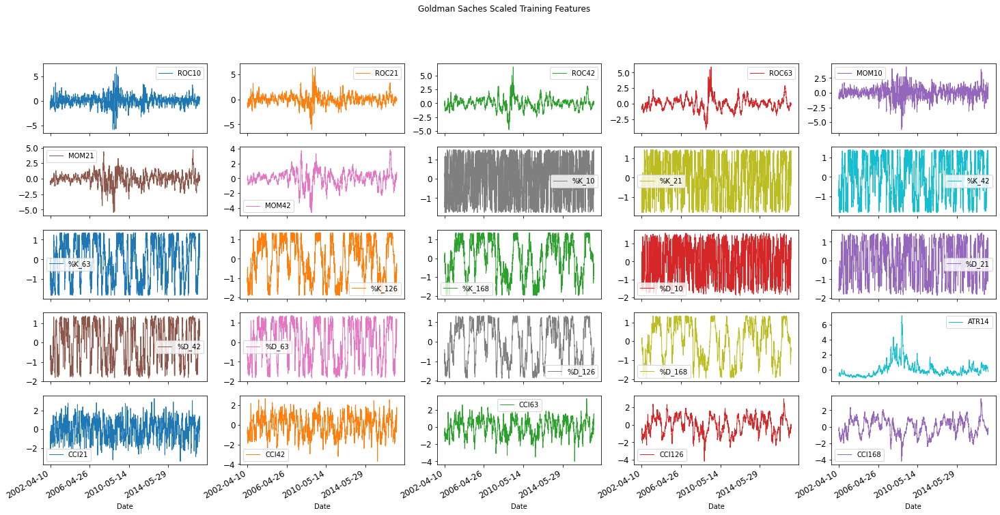

In [ ]:
# Plot the scaled_train_features based on
'''
if the test accuracy of VIF features is bigger than the test accuracy of Kbest features, 
plot scaled VIF feature, otherwise, plot scaled Kbest features
'''
if (Kbest_test_acc <= VIF_test_acc ):
   SCALED_FEATURES = Scaled_X_VIF_TRAIN
else:
   SCALED_FEATURES = Scaled_X_Kbest_TRAIN

SCALED_FEATURES.plot(subplots=True,layout=(5,5),figsize=(25,12),fontsize=12, linewidth=1, title='Goldman Saches Scaled Training Features')
plt.show()

6.8 Autocorrelation and boxplot

In [ ]:
import statsmodels.api as sm  # seasonal trend decomposition
from statsmodels.graphics import tsaplots   # autocorrelation

def features_EDA(Dataset, Feature, decomp_model='multiplicative'):
    """ 
    Inputs: Dataset - input dataframe
            feature - features name in dataframe
            decomp_model - 'additive'/'multiplicative'
    Outputs: EDA statistics and plots of each feature
    """
    
    fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(12,8))
    fig.suptitle(f'features EDA of {Feature}', fontsize=16)
        
    # Observed values of the time series against target_class values
    Dataset[Feature].plot(ylim=[Dataset[Feature].min(),Dataset[Feature].max()],linewidth=2, ax=axs[0,0])
    axs[0,0].set_title('Target values (red/blue where target_class=0/1)')
    axs[0,0].set_xlabel('')
    axs[0,0].fill_between(Dataset.index, Dataset[Feature], where=(Dataset.Target==0),facecolor='red', alpha=0.5)
    axs[0,0].fill_between(Dataset.index, Dataset[Feature], where=(Dataset.Target==1),facecolor='blue', alpha=0.5)
    # plot a vertical line on 2020-03-12
    axs[0,0].axvline('2020-03-12', color='blue', linestyle='dashed')
    axs[0,0].axvline('2008-08-15', color='blue', linestyle='dashed')

    # Seasonality, trend and residual
    # freq is 252 for a daily data and 12 for monthly
    decomp = sm.tsa.seasonal_decompose(Dataset[Feature],model=decomp_model,freq=252)
    decomp.trend.plot(linewidth=2, ax=axs[0,1])
    axs[0,1].set_title('Trend')
    axs[0,1].set_xlabel('')
    decomp.seasonal.plot(linewidth=2, ax=axs[1,0])
    axs[1,0].set_title('Seasonality ')
    axs[1,0].set_xlabel('')
    decomp.resid.plot(linewidth=2, ax=axs[1,1])
    axs[1,1].set_title('Residual')
    axs[1,1].set_xlabel('')
    
    # Histogram
    Dataset[Feature].plot.hist(bins=100, ax=axs[3,1])
    axs[3, 1].set_title('Histogram')
    Dataset[[Feature]].boxplot(ax=axs[3,0])
    axs[3, 0].set_title('Boxplot')
        
    # Autocorrelation
    tsaplots.plot_acf(Dataset[Feature], lags=21, ax=axs[2,1])
    tsaplots.plot_pacf(Dataset[Feature], lags=21, ax=axs[2,0])
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

In [ ]:
'''
if the test accuracy of VIF features is bigger than the test accuracy of Kbest features, 
plot EDA of VIF features otherwise, plot Kbest features
'''
VIF_dataset=pd.concat([X_VIF,Y],axis=1)
Kbest_dataset=pd.concat([X_Kbest,Y],axis=1)

if (Kbest_test_acc <= VIF_test_acc ):
   EDA_dataset = VIF_dataset
else:
   EDA_dataset = Kbest_dataset

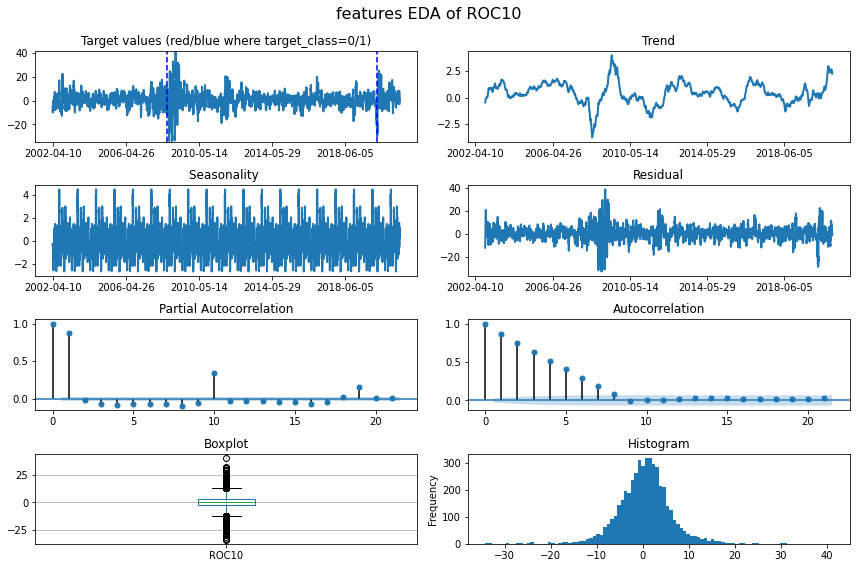

In [ ]:
# Call EDA function to examine the time series
# plot first feature of selected features dataset
features_EDA(EDA_dataset,EDA_dataset.columns[0], 'additive')

<a id='7'></a>
## 7. Deep Learning
Generating recurrent sequences from our time series

Time series is a sequence of numbers indexed by time:

$$x_{0},x_{1},x_{2},...,x_{T}$$

where $\{x_t\}$ is the numerical value in period $t$ and  $T$ is the total length of the series. 


I will generate sequences of 63 days, approximately three months, and use three layers with 16,32,16 units make different RNN models to predict the index value one timestep ahead. 

The input to every LSTM layer must have three dimensions, namely:
- **Samples**: One sequence is one sample. A batch contains one or more samples.
- **Time Steps**: One time step is one point of observation in the sample.
- **Features**: One feature is one observation at a time step.

I  create overlapping sequences using a window of 63 observations each.
For a simpler window of size T =6, obtain input-output pairs as shown in the following table:

$$\begin{array}{c|c}
\text{Input} & \text{Output}\\
\hline  {\langle x_1,x_2,x_3,x_4,x_5,x_6\rangle} & { x_7} \\
\ {\langle x_{2},x_{3},x_{4},x_{5},x_{6},x_{7} \rangle } & {x_{8} } \\
  {\vdots} & {\vdots}\\
 { \langle x_{T-6},x_{T-5},x_{T-4},x_{T-3},x_{T-2},x_{T-1} \rangle } &  {x_{T}}
\end{array}$$

<a id='7.1'></a>
### 7.1 Make RNN Models

Before make Deep Learning models, I define a funtion`def Compile_and_Fit(model,X_train, X_test,y_train, y_test, batch_size, epochs):`
to compile and fit models since I will make several models for comparison. In this function, I use checkpointer, EarlyStopping and ReduceLROnPlateau to speed up training by monitor validation accuracy. The optimizer I choose is Nadam with 0.001 learning rate. And validation set is 20% of training set. Since the order matters in time series, I set shuffle as False during fitting. Moreover, to avoid gradient vanishing and explode problem, I set clipnorm as1.0, which is to ensure gradient direction.


In [ ]:
#  define a function to compile and fit models

#  Patience is the number of epochs with no improvement after which training will be stopped.

def Compile_and_Fit(model,X_train, X_test,y_train, y_test, batch_size, epochs):

      '''
      to compile and fit deep learning models
      
      input:  model name ,X_train, X_test,y_train, y_test, batch_size, epochs
      output: model history
      '''

      results_path = Path('results', 'RNN_classifier')
      if not results_path.exists():
           results_path.mkdir(parents=True)

      RNN_PATH = (results_path / 'RNN.classification.h5').as_posix()

      checkpointer = ModelCheckpoint(filepath=RNN_PATH,
                                     verbose=1,
                                     patience=15,
                                     monitor='val_loss',
                                     mode='min',
                                     save_best_only=True)
      # early stop
      early_stopping = EarlyStopping(monitor='val_loss', 
                                     patience=15, 
                                     verbose=1,
                                     restore_best_weights=True,
                                     mode='min')
      
      # use performance scheduling to speed up covergence
      reduced_lr = ReduceLROnPlateau(monitor='val_loss', 
                                     verbose=1,
                                     patience=15, 
                                     mode='auto',
                                     factor=0.1, 
                                     min_lr=1e-9)
      
      # clipnorm is to address gradient vanishing / exploding problem, set as 1 is to ensure gradient direction
      optimizer = Nadam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07, clipnorm=1.0)    
      # optimizer = RMSprop(learning_rate=0.0001,rho=0.9, momentum=0.0, epsilon=1e-07, ) 
      start = time()
      # compile model 
      model.compile(loss='binary_crossentropy', optimizer = optimizer, metrics=['accuracy'])

      # Creating a directory for TensorBoard log files
      logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
      call_tensorboards = [tensorflow.keras.callbacks.TensorBoard(log_dir=logdir, 
                                                                  histogram_freq=1 # Records activation histograms every 1 epoch
                                                                  )]  
      # fit model
      history = model.fit(X_train, y_train,  
                          verbose=1, 
                          epochs=epochs, batch_size= batch_size , 
                          callbacks=[reduced_lr,early_stopping, checkpointer, call_tensorboards],
                          validation_split=0.2,
                          shuffle=False)    
      # clear epoches
      IPython.display.clear_output()

      print(f'Training was completed in {time() - start:.2f} secs')
      print('-'*65)

      return history

In [ ]:
# assign values to N_Timesteps and N_features
N_Timesteps, N_Features = X_train.shape[1], X_train.shape[2]
N_Timesteps, N_Features

(63, 25)

In [ ]:
# assign values of hyperparameters
DP = 0.1                # dropout rate
NEURONS = [16,32,16,1]  # number of Neurons in layers
BACH_SIZE = 16          # batch size
EPOCHS = 200            # number of epochs
LAMBDA = 0.001          # L2 regularizer
ACT = 'selu'            # activation. function
INI = 'lecun_normal'    # initializer funtion

In [ ]:
# initialize two dictionary to save loss and accuary of validation and testing datasets
valid_loss_acc = {}
test_loss_acc  = {}

Mode 1: MLP
Make a Dense model with 1 layer 16 units as a baseline model.

In [ ]:
# make a MLP model as baseline
MLP_model = Sequential([
                        Dense(NEURONS[0], 
                              input_shape=(N_Timesteps, N_Features), 
                              kernel_initializer=INI,
                              activation=ACT, 
                              kernel_regularizer=l2(LAMBDA)),
                        Dropout(DP),
                        Dense(NEURONS[1],kernel_initializer=INI,
                              activation=ACT,
                              kernel_regularizer=l2(LAMBDA)),
                        Dropout(DP),
                        Dense(NEURONS[2],kernel_initializer=INI,
                              activation=ACT,
                              kernel_regularizer=l2(LAMBDA) ), 
                        Dropout(DP),                                           
                        Dense(NEURONS[3], activation='sigmoid')
                  ])

# compile and fit model
MLP_history = Compile_and_Fit(MLP_model,X_train,X_test,y_train,y_test, batch_size=BACH_SIZE, epochs=EPOCHS)

valid_loss_acc['MLP'] = MLP_model.evaluate(X_train,y_train, verbose=1)
test_loss_acc['MLP'] = MLP_model.evaluate(X_test,y_test, verbose=1)

Training was completed in 136.84 secs
-----------------------------------------------------------------
30/30 [==============================] - 0s 2ms/step - loss: 0.7074 - accuracy: 0.5893


In [ ]:
#%load_ext tensorboard
#%tensorboard --logdir logs

Mode 2: simple RNN

Make a simple RNN model 

In [ ]:
# make a simple RNN model
# A RNN layer that returns its full output sequence
SimpleRNN_model = Sequential([
                  SimpleRNN(NEURONS[0], 
                            input_shape=(N_Timesteps, N_Features),
                            return_sequences=True,
                            kernel_initializer=INI,
                            activation=ACT, 
                            dropout=(DP),
                            recurrent_dropout =DP,
                            kernel_regularizer=l2(LAMBDA)),
                  SimpleRNN(NEURONS[0], kernel_initializer=INI,
                            activation=ACT, 
                            dropout=(DP),
                            recurrent_dropout=DP,
                            return_sequences=True,
                            kernel_regularizer=l2(LAMBDA)),                 
                  SimpleRNN(NEURONS[0], kernel_initializer=INI,
                            activation=ACT,
                            dropout=(DP),
                            recurrent_dropout=DP,
                            return_sequences=True, 
                            kernel_regularizer=l2(LAMBDA)), 
                  Dense(NEURONS[3], activation='sigmoid') 
                  ])
# compile and fit model
SimpleRNN_history = Compile_and_Fit(SimpleRNN_model,X_train,X_test,y_train,y_test, batch_size=BACH_SIZE, epochs=25)

valid_loss_acc['SimpleRNN'] = SimpleRNN_model.evaluate(X_train,y_train, verbose=1)
test_loss_acc['SimpleRNN'] = SimpleRNN_model.evaluate(X_test,y_test, verbose=1)

Training was completed in 200.57 secs
-----------------------------------------------------------------
30/30 [==============================] - 0s 9ms/step - loss: 0.7364 - accuracy: 0.5725


Model 3: LSTM

Make a LSTM model. To avoid gradient vanishing/explode problem and overfitting, I use dropout and L2 regularizer in each layer. And I use BatchNormalization to remove the bias term from the previous. Batch normalization applies a transformation that maintains the mean output close to 0 and the output standard deviation close to 1.Activation is set as 'selu'

In [ ]:
# make LSTM model
# define a LSTM model with three cells
# selu requires lecun_normal initializer
# dropout and regularizer are set to address overfitting

LSTM_model = Sequential([
                         LSTM(NEURONS[0], 
                              input_shape=(N_Timesteps, N_Features),
                              return_sequences=True,
                              kernel_initializer=INI,
                              activation=ACT,
                              dropout=DP,
                              recurrent_dropout=DP,
                              kernel_regularizer=l2(LAMBDA)
                              ),
                         #BatchNormalization(),
                         LSTM(NEURONS[1],
                              kernel_initializer=INI,
                              activation=ACT, 
                              dropout=DP,
                              recurrent_dropout=DP,                              
                              return_sequences=True, 
                              kernel_regularizer=l2(LAMBDA), 
                              ),                  
                         #BatchNormalization(),
                         LSTM(NEURONS[2],
                              kernel_initializer=INI,
                              activation=ACT, 
                              dropout=DP,
                              recurrent_dropout=DP,                              
                              return_sequences=True, 
                              kernel_regularizer=l2(LAMBDA),
                              ),
                         #BatchNormalization(),                                     
                         Dense(NEURONS[3], activation ='sigmoid')
                        ])
# compile and fit model
LSTM_history = Compile_and_Fit(LSTM_model,X_train,X_test,y_train,y_test, batch_size=BACH_SIZE, epochs=25)

valid_loss_acc['LSTM'] = LSTM_model.evaluate(X_train,y_train, verbose=1)
test_loss_acc['LSTM'] = LSTM_model.evaluate(X_test,y_test, verbose=1)

Training was completed in 574.01 secs
-----------------------------------------------------------------
30/30 [==============================] - 1s 19ms/step - loss: 1.0408 - accuracy: 0.4766


Model 4: GRU model

GRU get rid of  cell state and used the hidden state to control information flow. Unlike LSTM, GRU only has two gates, a reset gate and update gate. General, GRU is takes less time for training. And this model does not use drop and regularizer term.

In [ ]:
# make a GRU model 
GRU_model = Sequential([
                        GRU(NEURONS[0], 
                            input_shape=(N_Timesteps, N_Features), 
                            return_sequences=True,
                            kernel_initializer=INI,
                            activation=ACT, 
                            dropout=DP,
                            recurrent_dropout=DP,                            
                            kernel_regularizer=l2(LAMBDA)),
                        GRU(NEURONS[1], kernel_initializer=INI,
                            activation=ACT, 
                            dropout=DP,
                            recurrent_dropout=DP, 
                            return_sequences=True,
                            kernel_regularizer=l2(LAMBDA)),
                        GRU(NEURONS[2], kernel_initializer=INI,
                            activation=ACT, 
                            dropout=DP,
                            recurrent_dropout=DP, 
                            return_sequences=True,
                            kernel_regularizer=l2(LAMBDA)),
                        Dense(NEURONS[3], activation='sigmoid')
                       ])

GRU_history = Compile_and_Fit(GRU_model,X_train, X_test, y_train, y_test, batch_size=BACH_SIZE, epochs=25)

valid_loss_acc['GRU'] = GRU_model.evaluate(X_train, y_train, verbose=1)
test_loss_acc['GRU'] = GRU_model.evaluate(X_test,y_test, verbose=1)

Training was completed in 448.09 secs
-----------------------------------------------------------------
30/30 [==============================] - 1s 17ms/step - loss: 0.7997 - accuracy: 0.5834


Like LSTM layer, the CNN_LSTM input transformations and recurrent transformations are both convolutional. The Conv1D-LSTM structure involves using Convolutional Neural Network (CNN) layers for feature extraction on input data combined with LSTMs to support sequence prediction. To implement, split TIME_STEP into two sub time steps for input.

In [ ]:
# define cnn-lstm model with two Conv1D layers
# reshape data for CNN # N_Steps *  N_Length = TIME_STEP
N_Steps, N_Length = 3, 21
X_train_Conv1D = X_train.reshape((X_train.shape[0], N_Steps, N_Length, N_Features))
X_test_Conv1D  = X_test.reshape((X_test.shape[0], N_Steps, N_Length, N_Features))

Conv1D_LSTM_model = Sequential([TimeDistributed(Conv1D(filters=NEURONS[0], 
                                                       kernel_regularizer=l2(LAMBDA),
                                                       kernel_size=2, 
                                                       kernel_initializer=INI,activation=ACT),
                                                       input_shape=(None, N_Length, N_Features)),
                               TimeDistributed(Conv1D(filters=NEURONS[1], kernel_size=2, 
                                                      kernel_initializer=INI,activation=ACT,
                                                      kernel_regularizer=l2(LAMBDA))),
                               TimeDistributed(Dropout(DP)),
                               TimeDistributed(MaxPooling1D(pool_size=2)), 
                               TimeDistributed(Flatten()),  
                               LSTM(NEURONS[2],kernel_initializer=INI,
                                    activation=ACT,                              
                                    dropout=DP,
                                    recurrent_dropout=DP,
                                    kernel_regularizer=l2(LAMBDA)),
                               #Dense(NEURONS[2], activation='elu',kernel_initializer='he_normal'),
                               Dense(NEURONS[3],  activation='sigmoid')
                              ])

Conv1D_LSTM_history = Compile_and_Fit(Conv1D_LSTM_model,X_train_Conv1D,X_test_Conv1D,y_train,y_test,batch_size=BACH_SIZE, epochs=EPOCHS)

valid_loss_acc['Conv1D_LSTM'] = Conv1D_LSTM_model.evaluate(X_train_Conv1D, y_train, verbose=1)
test_loss_acc['Conv1D_LSTM'] = Conv1D_LSTM_model.evaluate(X_test_Conv1D, y_test, verbose=1)

Training was completed in 56.83 secs
-----------------------------------------------------------------
30/30 [==============================] - 0s 3ms/step - loss: 0.1642 - accuracy: 0.9526


Model 6: ConvLSTM 

An extension of the CNN-LSTM  is to perform the convolutions of the CNN  as part of the LSTM model. This variant is called ConvLSTM model and can also be used for spatiotemporal data. Its input shape is **[samples, time, rows, cols, channels]**

* Samples:    number of windows in the dataset
* Time:       subsequences window 
* Rows:      shape of each subsequence
* Columns:    time steps in an input subsequence
* Channels:   input variables.

In [ ]:
 # make ConvLSTM model with 1 ConvLSTM2D layers
 
# input shape is (samples, time steps, rows, cols, channels)

N_Steps, N_Length = 3, 21 # N_Steps *  N_Length = TIME_STEP
X_train_Con2D = X_train.reshape((X_train.shape[0], N_Steps,1, N_Length, N_Features))
X_test_Con2D  = X_test.reshape((X_test.shape[0], N_Steps,1, N_Length, N_Features))

ConvLSTM2D_model = Sequential([ # filters is the dimensionality of the output space
                               ConvLSTM2D(filters=NEURONS[0], 
                                          input_shape=(N_Steps, 1, N_Length, N_Features), 
                                          kernel_size=(1,5), 
                                          kernel_initializer=INI,
                                          activation=ACT,
                                          dropout=DP,
                                          recurrent_dropout=DP,
                                          kernel_regularizer=l2(LAMBDA),
                                          return_sequences=True),       
                               Dense(NEURONS[1], kernel_initializer=INI,activation=ACT),
                               Dropout(DP),
                               Flatten(),
                               Dense(NEURONS[3], activation='sigmoid')
                              ])

ConvLSTM2D_history = Compile_and_Fit(ConvLSTM2D_model,X_train_Con2D,X_test_Con2D,y_train,y_test,batch_size=BACH_SIZE, epochs=EPOCHS)

valid_loss_acc['ConvLSTM2D'] = ConvLSTM2D_model.evaluate(X_train_Con2D ,y_train, verbose=1)
test_loss_acc['ConvLSTM2D'] = ConvLSTM2D_model.evaluate(X_test_Con2D,y_test, verbose=1)

Training was completed in 77.29 secs
-----------------------------------------------------------------
30/30 [==============================] - 0s 4ms/step - loss: 0.2025 - accuracy: 0.9453


check training history via tensorflowboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

<a id='7.2'></a>
### 7.2 Evaluate Performace


In [ ]:
# make a dataframe to store the accuracy and loss of validation and testing dataset
test_performance = pd.DataFrame(test_loss_acc, index=['Test loss','Test acc'])
valid_performance = pd.DataFrame(valid_loss_acc, index=['Valid loss','Valid acc'])
performance = pd.concat([test_performance,valid_performance],axis=0)
performance

,MLP,SimpleRNN,LSTM,GRU,Conv1D_LSTM,ConvLSTM2D
Test loss,0.7074,0.7364,1.0408,0.7997,0.1642,0.2025
Test acc,0.5893,0.5725,0.4766,0.5834,0.9526,0.9453
Valid loss,0.5833,0.6209,0.7345,0.6751,0.0628,0.0398
Valid acc,0.7016,0.6915,0.6890,0.6969,0.9893,0.9898


This table show that LSTM models have worst training accuracy, MLP, SimpleRNN, and GUR yield a higher accuarcy. Conv1D_LSTM  and ConvLSTM2D producs a very high accuracy in training and testing dataset

In [ ]:
# plot models' performance 
performance.iplot(kind='bar', title='Goldman Saches: Deep Learning Perfomance 1')

In [ ]:
# plot models' performance 
performance.T.iplot(kind='bar',title='Goldman Saches: Deep Learning Perfomance 2')

Display training history 

In [ ]:
#plot training history
pd.DataFrame(MLP_history.history).drop(['lr'],axis=1).iplot(title ='Goldman Saches model 1: MLP training history',
                                                                   xaxis_title ='Number of Epoches')

In [ ]:
#plot training history
pd.DataFrame(SimpleRNN_history.history).drop(['lr'],axis=1).iplot(title ='Goldman Saches model 2: SimpleRNN training history',
                                                                   xaxis_title ='Number of Epoches')

In [ ]:
#plot training history
pd.DataFrame(LSTM_history.history).drop(['lr'],axis=1).iplot(title ='Goldman Saches model 3: LSTM training history',
                                                                   xaxis_title ='Number of Epoches')

In [ ]:
#plot training history
pd.DataFrame(GRU_history.history).drop(['lr'],axis=1).iplot(title ='Goldman Saches model 4: GRU training history',
                                                                   xaxis_title ='Number of Epoches')

In [ ]:
# plot training history
pd.DataFrame(Conv1D_LSTM_history.history).drop(['lr'],axis=1).iplot(title ='Goldman Saches model 5: Conv1D LSTM training history',
                                                                    xaxis_title ='Number of Epoches')

In [ ]:
#plot training history
pd.DataFrame(ConvLSTM2D_history.history).drop(['lr'],axis=1).iplot(title ='Goldman Saches model 6: ConvLSTM2D training history',
                                                                   xaxis_title ='Number of Epoches')

In [ ]:
# model summary
Conv1D_LSTM_model.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
time_distributed (TimeDistri (None, None, 20, 16)      816       
_________________________________________________________________
time_distributed_1 (TimeDist (None, None, 19, 32)      1056      
_________________________________________________________________
time_distributed_2 (TimeDist (None, None, 19, 32)      0         
_________________________________________________________________
time_distributed_3 (TimeDist (None, None, 9, 32)       0         
_________________________________________________________________
time_distributed_4 (TimeDist (None, None, 288)         0         
_________________________________________________________________
lstm_6 (LSTM)                (None, 16)                19520     
_________________________________________________________________
dense_10 (Dense)             (None, 1)                

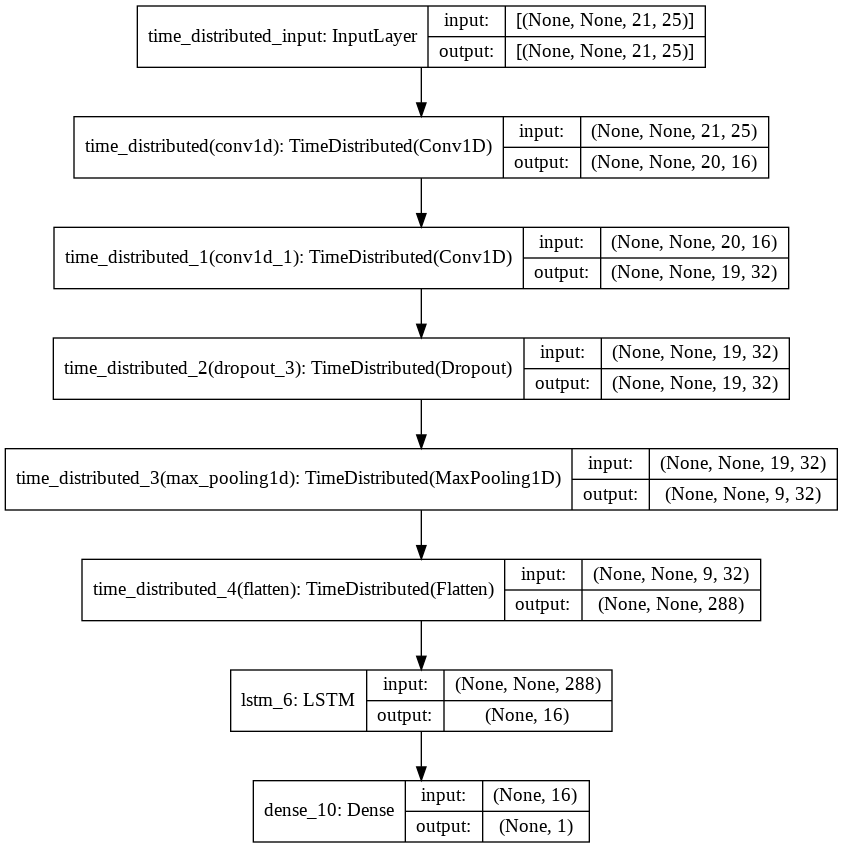

In [ ]:
# plot model structure
from tensorflow.keras.utils import plot_model
plot_model(Conv1D_LSTM_model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
# print accuracy score, comfusion matrix and classification report
Conv1D_pred = (Conv1D_LSTM_model.predict(X_test_Conv1D) > 0.5).astype("int32")[:, 0]
print(accuracy_score(y_test,Conv1D_pred))
print(confusion_matrix(y_test, Conv1D_pred))
print(classification_report(y_test, Conv1D_pred))

0.9526315789473684
[[322  12]
 [ 33 583]]
              precision    recall  f1-score   support

         0.0       0.91      0.96      0.93       334
         1.0       0.98      0.95      0.96       616

    accuracy                           0.95       950
   macro avg       0.94      0.96      0.95       950
weighted avg       0.95      0.95      0.95       950



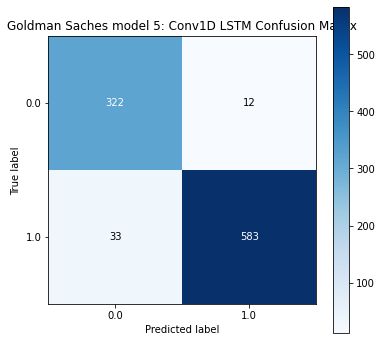

In [ ]:
# Plot confusion matrix
import scikitplot as skplt
skplt.metrics.plot_confusion_matrix(y_test, Conv1D_pred,figsize=(6,6),title='Goldman Saches model 5: Conv1D LSTM Confusion Matrix')

In [ ]:
# plot ROC AUC curve 
from sklearn.metrics import roc_curve, auc

y_score = Conv1D_LSTM_model.predict(X_test_Conv1D)[:, 0]
fpr, tpr, thresholds = roc_curve(y_test, y_score)

fig = px.area(
    x=fpr, y=tpr,
    title=f'Goldman Saches model 5: Conv1D LSTM ROC Curve (AUC={auc(fpr, tpr):.4f})',
    labels=dict(x='False Positive Rate', y='True Positive Rate'),
    width=700, height=500)
fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1)

fig.update_yaxes(scaleanchor="x", scaleratio=1)
fig.update_xaxes(constrain='domain')
fig.show()

<a id='7.3'></a>
### 7.3 Model Tuning 

In this section I will tune ConvLSTM2D model to improve the performance of ConvLSTM2D model.

In [ ]:
N_Steps, N_Length = 3, 21 # N_Steps *  N_Length = TIME_STEP
X_train_Con2D = X_train.reshape((X_train.shape[0], N_Steps,1, N_Length, N_Features))
X_test_Con2D  = X_test.reshape((X_test.shape[0], N_Steps,1, N_Length, N_Features))

# define a LSTM model for tuning
def tuning_ConvLSTM2D_model(N_Hidden=1,#  number of hidden layers
                      N_Neurons=16,  # umber of units
                      LR=0.01,       # earning rate
                      DP=0,        # dropout rate
                      OPTIMIZER=Adam,# optimizer
                      ACTIVATION='selu',
                      INPUT_SHAPE=(N_Steps, 1, N_Length, N_Features),
                      ):    
    # selu needs to be with lecun_normal
    if (ACTIVATION=='selu'):
          INITIALIZER='lecun_normal'
    else:
           NITIALIZER='he_normal'     
    # build model
    model= Sequential()
    options = {"input_shape": INPUT_SHAPE}
    for layer in range(N_Hidden):    
        model.add(ConvLSTM2D(filters=N_Neurons,  kernel_size=(1,5), activation=ACTIVATION, 
                            kernel_initializer=INITIALIZER, kernel_regularizer=l2(LAMBDA),
                            dropout=DP,  **options)) 
        options = {}
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid',**options))
    # optimizer
    optimizer = OPTIMIZER(learning_rate = LR)
    model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    return model
# save to KerasClassifier for tuning
clf_ConvLSTM2D = KerasClassifier(tuning_ConvLSTM2D_model, epochs = 30, verbose = 1)

Define call back: checkpointer, early stopping and reduced learning

In [ ]:
results_path = Path('results', 'RNN_classifier')
if not results_path.exists():
    results_path.mkdir(parents=True)
# define path
RNN_PATH = (results_path / 'RNN.classification.h5').as_posix()
# check point
checkpointer = ModelCheckpoint(filepath=RNN_PATH, patience=5, verbose=1,monitor='val_loss',mode='min',save_best_only=True)
# early stop
early_stopping = EarlyStopping(monitor='val_loss', patience=5, verbose=1,restore_best_weights=True,mode='min')    
# use performance scheduling to speed up covergence
reduced_lr = ReduceLROnPlateau(monitor='val_loss', patience=5, verbose=1, mode='auto',factor=0.1, min_lr=1e-9)    


Test if 'tuning_ConvLSTM_model' funtion works

In [ ]:
# fit model
ConvLSTM2D_history = clf_ConvLSTM2D.fit(X_train_Con2D, y_train, epochs=2,validation_split=0.2, shuffle=False, verbose=1, 
                     callbacks=[early_stopping,reduced_lr,checkpointer])
# clear epoches 
IPython.display.clear_output()
# evaluate model
acc_ConvLSTM2D = clf_ConvLSTM2D.score(X_test_Con2D, y_test)
# predict model
y_pred = clf_ConvLSTM2D.predict(X_test_Con2D) 

30/30 [==============================] - 0s 3ms/step - loss: 0.1836 - accuracy: 0.9547


In this section, I will tune the hyperparameters of ConvLSTM2D model

Use 'Grid_Search' to tune hyperparameters

In [ ]:
# tuning hyperparameters using GridsearchCV
from sklearn.model_selection import GridSearchCV

# define parameters dictionary
param_dict = {'N_Neurons': [16,32,64],
              'N_Hidden':[1,2,3],
              'LR': [5e-7,5e-5,5e-3], 
              'DP':[0.1, 0.3, 0.5],
              'ACTIVATION':['relu','elu','selu'],
              'OPTIMIZER':[Nadam, Adam, RMSprop]
              }
# grid search
Grid_Search = GridSearchCV(estimator=clf_ConvLSTM2D, param_grid=param_dict, n_jobs=-1, cv=3)
# fit model
start = time()
Grid_Search_history = Grid_Search.fit(X_train_Con2D, y_train, epochs=30, validation_split=0.2,verbose=1, shuffle=False)

IPython.display.clear_output()     
print(f'Model Tuning was completed in {time() - start:.2f} secs')
print('-'*65)

Model Tuning was completed in 1548.33 secs
-----------------------------------------------------------------


In [ ]:
# display best parameters
Grid_Search.best_params_

{'ACTIVATION': 'selu',
 'DP': 0.3,
 'LR': 5e-05,
 'N_Hidden': 1,
 'N_Neurons': 64,
 'OPTIMIZER': keras.optimizer_v2.rmsprop.RMSprop}

In [ ]:
# best score of tuned model
Grid_Search.best_score_

0.9681469599405924

In [ ]:
# assign model
tuned_ConvLSTM2D_model = Grid_Search.best_estimator_.model
# evaluate tuned model
valid_loss_acc['tuned_ConvLSTM2D'] = tuned_ConvLSTM2D_model.evaluate(X_train_Con2D ,y_train, verbose=1)
test_loss_acc['tuned_ConvLSTM2D'] = tuned_ConvLSTM2D_model.evaluate(X_test_Con2D,y_test, verbose=1)

30/30 [==============================] - 0s 6ms/step - loss: 0.3001 - accuracy: 0.9537


In [ ]:
# update performance
test_performance = pd.DataFrame(test_loss_acc, index=['Test loss','Test acc'])
valid_performance = pd.DataFrame(valid_loss_acc, index=['Valid loss','Valid acc'])
performance = pd.concat([test_performance,valid_performance],axis=0)
performance

,MLP,SimpleRNN,LSTM,GRU,Conv1D_LSTM,ConvLSTM2D,tuned_ConvLSTM2D
Test loss,0.7074,0.7364,1.0408,0.7997,0.1642,0.2025,0.3001
Test acc,0.5893,0.5725,0.4766,0.5834,0.9526,0.9453,0.9537
Valid loss,0.5833,0.6209,0.7345,0.6751,0.0628,0.0398,0.2104
Valid acc,0.7016,0.6915,0.6890,0.6969,0.9893,0.9898,0.9874


Unfortunately after tuning, the test accuracy of COVLSTM2D model is 78.53%, which small than before tuning, performance, does not improve. 

In [ ]:
# display accuracy score, confusion matrix and classification report of tuned model
tuned_ConvLSTM2D_pred = (tuned_ConvLSTM2D_model.predict(X_test_Con2D) > 0.5).astype("int32")[:, 0]
print(accuracy_score(y_test, tuned_ConvLSTM2D_pred))
print(confusion_matrix(y_test, tuned_ConvLSTM2D_pred))
print(classification_report(y_test, tuned_ConvLSTM2D_pred))

0.9536842105263158
[[326   8]
 [ 36 580]]
              precision    recall  f1-score   support

         0.0       0.90      0.98      0.94       334
         1.0       0.99      0.94      0.96       616

    accuracy                           0.95       950
   macro avg       0.94      0.96      0.95       950
weighted avg       0.96      0.95      0.95       950



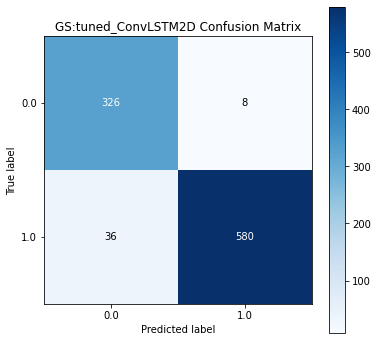

In [ ]:
# Plot confusion matrix
import scikitplot as skplt
skplt.metrics.plot_confusion_matrix(y_test, tuned_ConvLSTM2D_pred,figsize=(6,6),title='GS:tuned_ConvLSTM2D Confusion Matrix')

In [ ]:
# plot ROC ACU curve
y_score = tuned_ConvLSTM2D_model.predict(X_test_Con2D)[:, 0]
fpr, tpr, thresholds = roc_curve(y_test, y_score)

fig = px.area(
    x=fpr, y=tpr,
    title=f'Goldman Saches: ConvLSTM2D model ROC Curve (AUC={auc(fpr, tpr):.4f})',
    labels=dict(x='False Positive Rate', y='True Positive Rate'),
    width=700, height=500)
fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1)

fig.update_yaxes(scaleanchor="x", scaleratio=1)
fig.update_xaxes(constrain='domain')
fig.show()

 <a id='8'></a>
## 8 BackTest

Define a trading strategy in ConvLSTM2D model. Use the predicted signal to buy or sell and then compare the result of this strategy with the buy and sell and visualize the performance of this algorithms.

* notice: this back test does consider trading cost

In [ ]:
# recall train and test split
N=len(X)
X_TRAIN, X_TEST = X[0:int(N*0.8)],  X[int(N*0.8):]
Y_TRAIN, Y_TEST = Y[0:int(N*0.8)],  Y[int(N*0.8):]

In [ ]:
# Backtest
backtest = pd.DataFrame(index=X_TEST.index)
backtest['actual_signal'] = Y_TEST
backtest['Market Returns'] = X.Chg_1
backtest['Actual'] = backtest['Market Returns'] * backtest['actual_signal'].shift(1)
# use tuned CovLSTM2D model
backtest['ConvLSTM2D signal_pred'] = pd.DataFrame(tuned_ConvLSTM2D_pred,index=X_TEST.index)
backtest['ConvLSTM2D Strategy'] = backtest['Market Returns'] * backtest['ConvLSTM2D signal_pred'].shift(1)
# test with Conv1D model
backtest['Conv1D signal_pred'] = pd.DataFrame(Conv1D_pred,index=X_TEST.index)
backtest['Conv1D LSTM Strategy'] = backtest['Market Returns'] * backtest['Conv1D signal_pred'].shift(1)
#reset index
backtest=backtest.reset_index()
# plot backtesting
backtest[['Actual',
          'ConvLSTM2D Strategy',
          'Conv1D LSTM Strategy'
          ]].cumsum().iplot(kind='spread',
                            title = 'Goldman Saches: Backtesting',
                            xaxis_title = 'Time Periods', 
                            yaxis_title = 'Cumulaitive return')

 <a id='9'></a>
## 9 Appendix EDA

9.1 K-Means

k-Means is the most famous clustering algorithm and was originally proposed by Stuart Lloyd at Bell Labs in 1957. 

This algorithm finds K centroids and assigns each dada to  one cluster and  typically uses Euclidean distance.

In [ ]:
from sklearn import cluster
# assign the original features to kmeans data
Kmeans_data = X

#Calculate average annual percentage return and volatilities over a theoretical one year period
data_Kmeans = Kmeans_data.pct_change().mean() * 252
data_Kmeans = pd.DataFrame(data_Kmeans)
data_Kmeans.columns = ['Returns']
data_Kmeans['Volatility'] = Kmeans_data.pct_change().std() * np.sqrt(252)
# drop null value
data_Kmeans.dropna(inplace=True)

scaler = StandardScaler().fit(data_Kmeans)
rescaledDataset = pd.DataFrame(scaler.fit_transform(data_Kmeans),columns = data_Kmeans.columns, index = data_Kmeans.index)
# summarize transformed data
rescaledDataset.head(2)
X_kmeans=rescaledDataset
X_kmeans.head(2)

#Fit with k-means
k_means = cluster.KMeans(n_clusters=2)
k_means.fit(X_kmeans)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [ ]:
#Extracting labels 
target_labels = k_means.predict(X_kmeans)
#Printing the labels
target_labels

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

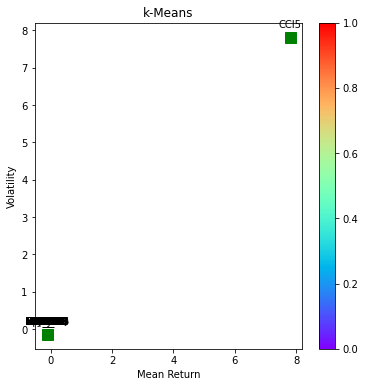

In [ ]:
centroids = k_means.cluster_centers_
fig = plt.figure(figsize=(6,6))
ax = fig.add_subplot(111)
scatter = ax.scatter(X_kmeans.iloc[:,0],X_kmeans.iloc[:,1], c = k_means.labels_, cmap ="rainbow", label = X_kmeans.index)
ax.set_title('k-Means')
ax.set_xlabel('Mean Return')
ax.set_ylabel('Volatility')
plt.colorbar(scatter)

# zip joins x and y coordinates in pairs
for x,y,name in zip(X_kmeans.iloc[:,0],X_kmeans.iloc[:,1],X_kmeans.index):

    label = name

    plt.annotate(label, # this is the text
                 (x,y), # this is the point to label
                 textcoords="offset points", # how to position the text
                 xytext=(0,10), # distance from text to points (x,y)
                 ha='center') # horizontal alignment can be left, right or center
    
plt.plot(centroids[:,0],centroids[:,1],'sg',markersize=11)

In [ ]:
cluster_label = pd.concat([pd.DataFrame(X_kmeans.index), pd.DataFrame(k_means.labels_)],axis = 1)
cluster_label.columns =['features','Cluster']
cluster_label.sort_values(by=['Cluster'])

,features,Cluster
0,EFFR,0
32,%D_5,0
33,%D_10,0
34,%D_21,0
35,%D_42,0
...,...,...
26,RSI21,0
27,RSI42,0
14,EMA5,0
61,LowerBB,0


9.2 Self-Organizing Maps

 [ 10000 / 10000 ] 100% - 0:00:00 left 
 quantization error: 1.395969379577695e-09


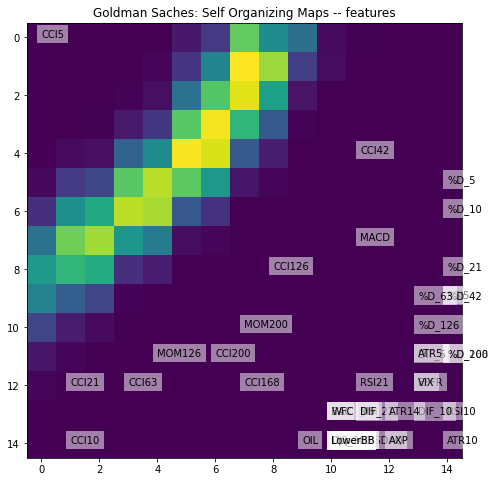

In [ ]:
# Initialize a 15x15 SOM
from minisom import MiniSom
data_som = StandardScaler().fit_transform(data_Kmeans)
som = MiniSom(15, 15, 2, learning_rate=0.5, sigma=5, random_seed=42,topology='hexagonal')
# Initialize with randon weights
som.random_weights_init(data_som )
# Trains SOM with 10000 iterations
som.train_batch(data_som ,10000, verbose=True)
# Plot SOM
plt.figure(figsize=(8, 8))
for ix in range(len(data_som)):
    winner = som.winner(data_som[ix])
    plt.text(winner[0], winner[1], cluster_label.features[ix], bbox=dict(facecolor='white',alpha=0.5, lw=0)) 
plt.imshow(som.distance_map())
plt.grid(False)
plt.title('Goldman Saches: Self Organizing Maps -- features');

In [ ]:
# define a funtion to display complex and nonlinear statistical relationships n high-dimensional data via Self Organizing Maps
from minisom import MiniSom

def train_plot_som(features,data,filter_lenth,filter_width,lr,sigma):

    # scale features
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(features)
    
    som = MiniSom(filter_lenth,filter_width, scaled_features.shape[1], learning_rate=lr, sigma=sigma, topology='hexagonal',random_seed=42)
    # Initialize with randon weights
    som.random_weights_init(scaled_features)
    # Trains SOM with 10000 iterations
    som.train_batch(scaled_features, 10000, verbose=True)
    # Plot SOM
    plt.figure(figsize=(15, 15))
    for ix in range(len(scaled_features)):
        winner = som.winner(scaled_features[ix])
        plt.text(winner[0], winner[1], data.Target[ix], bbox=dict(facecolor='white', alpha=0.2, lw=0)) 
    plt.imshow(som.distance_map(),cmap ='plasma')
    plt.grid(False)
    plt.title('Goldman Saches: Self Organizing Maps -- target')   

 [ 10000 / 10000 ] 100% - 0:00:00 left 
 quantization error: 1.1272908618746729


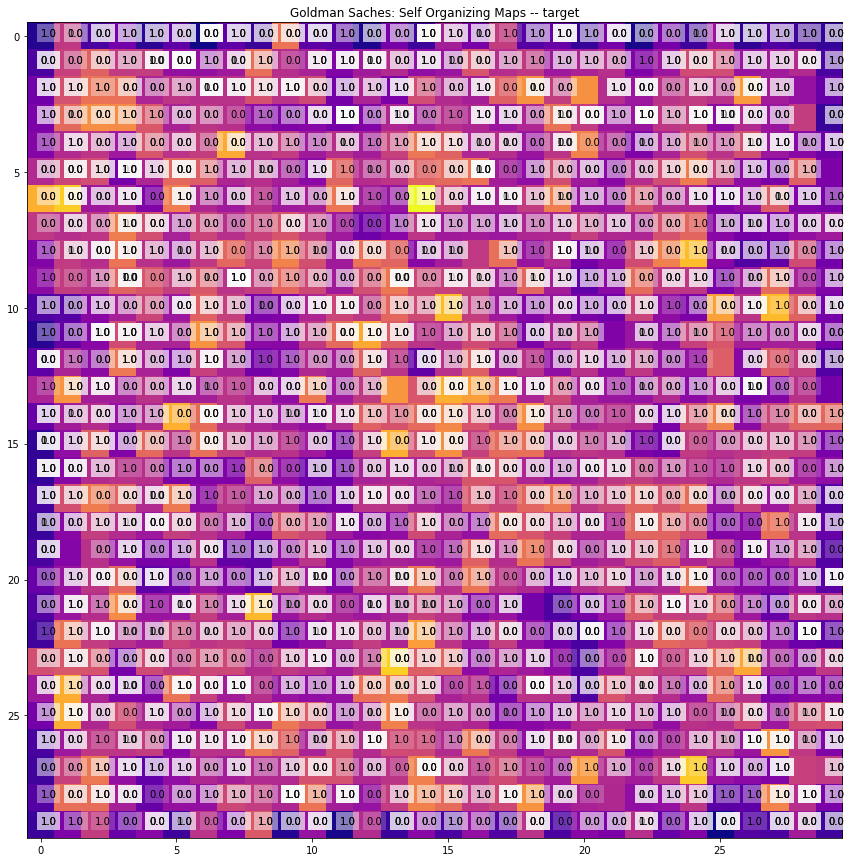

In [ ]:
# run train_plot_som function

'''
if the test accuracy of VIF features is bigger than the test accuracy of Kbest features, 
plot SOM of VIF features otherwise, plot Kbest features
'''
VIF_dataset=pd.concat([X_VIF,Y],axis=1)
Kbest_dataset=pd.concat([X_Kbest,Y],axis=1)

if (Kbest_test_acc <= VIF_test_acc ):
   SOM_features = X_VIF
   SOM_dataset = VIF_dataset
else:
   SOM_features = X_Kbest
   SOM_dataset = Kbest_dataset

train_plot_som(SOM_features, SOM_dataset, filter_lenth=30, filter_width=30, lr=1e-4, sigma=0.001)  